In [ ]:
!pip install numpy scipy plotly matplotlib

In [ ]:
import numpy as np
import time
import plotly.graph_objects as go
from scipy.spatial import Delaunay, ConvexHull, cKDTree
from scipy.optimize import fsolve
import matplotlib.pyplot as plt

In [ ]:
# def create_environment(environment_size, figure):
#     figure.update_layout(
#         scene=dict(
#             xaxis=dict(range=[0, environment_size]),
#             yaxis=dict(range=[0, environment_size]),
#             zaxis=dict(range=[0, environment_size])
#         ),
#         title='3D Imaging Simulation',
#         showlegend=True
#     )

# def place_object(environment_size, figure, object_low, object_high, object_size, object_seed, environment_center, object_center):
#     #environment_center = np.array([environment_size / 2, environment_size / 2, environment_size / 2])
#     np.random.seed(object_seed)
#     object_points = np.random.uniform(low=object_low, high=object_high, size=object_size)  # Ensure it's 3D points
#     #object_center = object_points.mean(axis=0)
#     shifted_object_points = object_points - object_center + environment_center
#     object_hull = ConvexHull(shifted_object_points)

#     # Plot the object using Mesh3d
#     figure.add_trace(go.Mesh3d(
#         x=shifted_object_points[:, 0],
#         y=shifted_object_points[:, 1],
#         z=shifted_object_points[:, 2],
#         alphahull=5,
#         opacity=0.3,
#         color='blue',
#         name='Object'
#     ))
#     return object_points

# def place_sensor(sensor_position, figure, sensor_range, num_spheres, object_points):
#     phi, theta = np.linspace(0, np.pi, 60), np.linspace(0, 2 * np.pi, 120)
#     phi, theta = np.meshgrid(phi, theta)

#     # Add the sensor point
#     figure.add_trace(go.Scatter3d(
#         x=[sensor_position[0]],
#         y=[sensor_position[1]],
#         z=[sensor_position[2]],
#         mode='markers',
#         marker=dict(size=5, color='red'),
#         name='Sensor'
#     ))

#     # Initialize an empty list for field points
#     field_points = []

#     # Add concentric spheres
#     for i in range(1, num_spheres + 1):
#         r = sensor_range * (i / num_spheres)  # Radius of the current sphere
#         x_field = r * np.sin(phi) * np.cos(theta) + sensor_position[0]
#         y_field = r * np.sin(phi) * np.sin(theta) + sensor_position[1]
#         z_field = r * np.cos(phi) + sensor_position[2]

#         # Collect all field points in the list
#         field_points.append(np.array([x_field.flatten(), y_field.flatten(), z_field.flatten()]).T)

#         figure.add_trace(go.Scatter3d(
#             x=x_field.flatten(),
#             y=y_field.flatten(),
#             z=z_field.flatten(),
#             mode='markers',
#             marker=dict(size=1, color='orange', opacity=0.2),
#             name=f'Field (r={r:.2f})'
#         ))

#     # Convert the list to a numpy array
#     field_points = np.concatenate(field_points, axis=0)

#     # Perform Delaunay triangulation on the object
#     hull_delaunay = Delaunay(object_points)

#     # Find which points are inside the convex hull
#     inside = hull_delaunay.find_simplex(field_points) >= 0
#     views = field_points[inside]

#     return views

# def reconstruct(views, figure):
#     figure.add_trace(go.Scatter3d(
#         x=views[:, 0],  # Extract the x-coordinates
#         y=views[:, 1],  # Extract the y-coordinates
#         z=views[:, 2],  # Extract the z-coordinates
#         mode='markers',
#         marker=dict(size=5, color='green'),
#         name='Reconstructed Model'
#     ))
#     figure.show()

# def place_em(pos, figure, environment_size, num_spheres, em_range):
#     phi, theta = np.linspace(0, np.pi, 60), np.linspace(0, 2 * np.pi, 120)
#     phi, theta = np.meshgrid(phi, theta)
#     figure.add_trace(go.Scatter3d(
#         x=[pos[0]],  # Extract the x-coordinates
#         y=[pos[1]],  # Extract the y-coordinates
#         z=[pos[2]],  # Extract the z-coordinates
#         mode='markers',
#         marker=dict(size=8, color='black'),
#         name='Electromagnet'
#     ))
#     field_points = []

#     for i in range(1, num_spheres + 1):
#         r = em_range * (i / num_spheres)  # Radius of the current sphere
#         x_field = r * np.sin(phi) * np.cos(theta) + pos[0]
#         y_field = r * np.sin(phi) * np.sin(theta) + pos[1]
#         z_field = r * np.cos(phi) + pos[2]

#         # Collect all field points in the list
#         field_points.append(np.array([x_field.flatten(), y_field.flatten(), z_field.flatten()]).T)

#         figure.add_trace(go.Scatter3d(
#             x=x_field.flatten(),
#             y=y_field.flatten(),
#             z=z_field.flatten(),
#             mode='markers',
#             marker=dict(size=0.2, color='gray', opacity=0.5),
#             name=f'Field (r={r:.2f})'
#         ))

In [ ]:
def create_environment(environment_size, figure):
    figure.update_layout(
        scene=dict(
            xaxis=dict(range=[0, environment_size]),
            yaxis=dict(range=[0, environment_size]),
            zaxis=dict(range=[0, environment_size])
        ),
        title='3D Imaging Simulation',
        showlegend=True
    )

def place_object(figure, object_low, object_high, object_size, object_seed, center_coords):
    np.random.seed(object_seed)
    # Generate random points for the object within the specified bounds
    object_points = np.random.uniform(low=object_low, high=object_high, size=object_size)
    # Calculate the object's original center
    object_center = object_points.mean(axis=0)
    # Shift points to the desired center
    shifted_object_points = object_points - object_center + center_coords
    # Compute convex hull for the object
    object_hull = ConvexHull(shifted_object_points)

    # Add the object to the 3D plot
    figure.add_trace(go.Mesh3d(
        x=shifted_object_points[:, 0],
        y=shifted_object_points[:, 1],
        z=shifted_object_points[:, 2],
        alphahull=5,
        opacity=0.3,
        color='blue',
        name='Object'
    ))
    return shifted_object_points

def place_sensor(sensor_position, figure, sensor_range, num_spheres, object_points):
    phi, theta = np.linspace(0, np.pi, 60), np.linspace(0, 2 * np.pi, 120)
    phi, theta = np.meshgrid(phi, theta)

    # Add the sensor point
    figure.add_trace(go.Scatter3d(
        x=[sensor_position[0]],
        y=[sensor_position[1]],
        z=[sensor_position[2]],
        mode='markers',
        marker=dict(size=5, color='red'),
        name='Sensor'
    ))

    # Initialize an empty list for field points
    field_points = []

    # Add concentric spheres
    for i in range(1, num_spheres + 1):
        r = sensor_range * (i / num_spheres)  # Radius of the current sphere
        x_field = r * np.sin(phi) * np.cos(theta) + sensor_position[0]
        y_field = r * np.sin(phi) * np.sin(theta) + sensor_position[1]
        z_field = r * np.cos(phi) + sensor_position[2]

        # Collect all field points in the list
        field_points.append(np.array([x_field.flatten(), y_field.flatten(), z_field.flatten()]).T)

        figure.add_trace(go.Scatter3d(
            x=x_field.flatten(),
            y=y_field.flatten(),
            z=z_field.flatten(),
            mode='markers',
            marker=dict(size=1, color='orange', opacity=0.8),
            name=f'Field (r={r:.2f})'
        ))

    # Convert the list to a numpy array
    field_points = np.concatenate(field_points, axis=0)

    # Perform Delaunay triangulation on the object
    hull_delaunay = Delaunay(object_points)

    # Find which points are inside the convex hull
    inside = hull_delaunay.find_simplex(field_points) >= 0
    views = field_points[inside]

    return views

def reconstruct(points, fig):
  tri = Delaunay(points[:, :2])
  triangles = tri.simplices

  # Step 4: Add triangles one by one in green
  for i, simplex in enumerate(triangles):
      simplex_points = points[simplex]
      fig.add_trace(go.Mesh3d(
          x=simplex_points[:, 0],
          y=simplex_points[:, 1],
          z=simplex_points[:, 2],
          color='green',
          opacity=0.8
      ))
      fig.update_layout(
          title=f'Triangulation Step {i + 1}',
          scene=dict(
              xaxis_title='X',
              yaxis_title='Y',
              zaxis_title='Z'
          )
      )
  fig.show()


# def place_em(pos, figure, environment_size, num_spheres, em_range):
#     phi, theta = np.linspace(0, np.pi, 60), np.linspace(0, 2 * np.pi, 120)
#     phi, theta = np.meshgrid(phi, theta)
#     figure.add_trace(go.Scatter3d(
#         x=[pos[0]],  # Extract the x-coordinates
#         y=[pos[1]],  # Extract the y-coordinates
#         z=[pos[2]],  # Extract the z-coordinates
#         mode='markers',
#         marker=dict(size=8, color='black'),
#         name='Electromagnet'
#     ))
#     field_points = []

#     for i in range(1, num_spheres + 1):
#         r = em_range * (i / num_spheres)  # Radius of the current sphere
#         x_field = r * np.sin(phi) * np.cos(theta) + pos[0]
#         y_field = r * np.sin(phi) * np.sin(theta) + pos[1]
#         z_field = r * np.cos(phi) + pos[2]

#         # Collect all field points in the list
#         field_points.append(np.array([x_field.flatten(), y_field.flatten(), z_field.flatten()]).T)

#         figure.add_trace(go.Scatter3d(
#             x=x_field.flatten(),
#             y=y_field.flatten(),
#             z=z_field.flatten(),
#             mode='markers',
#             marker=dict(size=0.2, color='gray', opacity=0.5),
#             name=f'Field (r={r:.2f})'
#         ))

Changes in code 03/02/2025

In [ ]:
def create_environment(environment_size, figure, object_seed):
    np.random.seed(object_seed)
    figure.update_layout(
        scene=dict(
            xaxis=dict(range=[0, environment_size]),
            yaxis=dict(range=[0, environment_size]),
            zaxis=dict(range=[0, environment_size])
        ),
        title='3D Imaging Simulation',
        showlegend=True
    )

def place_object(figure, object_low, object_high, object_size, object_seed, center_coords):
    np.random.seed(object_seed)
    # Generate random points for the object within the specified bounds
    object_points = np.random.uniform(low=object_low, high=object_high, size=object_size)
    # Calculate the object's original center
    object_center = object_points.mean(axis=0)
    # Shift points to the desired center
    shifted_object_points = object_points - object_center + center_coords
    # Compute convex hull for the object
    object_hull = ConvexHull(shifted_object_points)

    # Add the object to the 3D plot
    figure.add_trace(go.Mesh3d(
        x=shifted_object_points[:, 0],
        y=shifted_object_points[:, 1],
        z=shifted_object_points[:, 2],
        alphahull=5,
        opacity=0.3,
        color='blue',
        name='Object'
    ))
    return shifted_object_points

def place_sensor(sensor_position, figure, sensor_range, num_spheres, object_points, object_seed):
    np.random.seed(object_seed)
    phi, theta = np.linspace(0, np.pi, 60), np.linspace(0, 2 * np.pi, 120)
    phi, theta = np.meshgrid(phi, theta)

    # Add the sensor point
    figure.add_trace(go.Scatter3d(
        x=[sensor_position[0]],
        y=[sensor_position[1]],
        z=[sensor_position[2]],
        mode='markers',
        marker=dict(size=5, color='red'),
        name='Sensor'
    ))
    figure.show()

    # Initialize an empty list for field points
    field_points = []

    # Add concentric spheres
    for i in range(1, num_spheres + 1):
        r = sensor_range * (i / num_spheres)  # Radius of the current sphere
        x_field = r * np.sin(phi) * np.cos(theta) + sensor_position[0]
        y_field = r * np.sin(phi) * np.sin(theta) + sensor_position[1]
        z_field = r * np.cos(phi) + sensor_position[2]

        # Collect all field points in the list
        field_points.append(np.array([x_field.flatten(), y_field.flatten(), z_field.flatten()]).T)

        figure.add_trace(go.Scatter3d(
            x=x_field.flatten(),
            y=y_field.flatten(),
            z=z_field.flatten(),
            mode='markers',
            marker=dict(size=1, color='orange', opacity=0.3),
            name=f'Field (r={r:.2f})'
        ))

    # Convert the list to a numpy array
    field_points = np.concatenate(field_points, axis=0)

    # Perform Delaunay triangulation on the object
    hull_delaunay = Delaunay(object_points)

    # Find which points are inside the convex hull
    inside = hull_delaunay.find_simplex(field_points) >= 0
    views = field_points[inside]

    return views

def reconstruct(points, fig, object_seed):
  np.random.seed(object_seed)
  tri = Delaunay(points[:, :2])
  triangles = tri.simplices

  # Step 4: Add triangles one by one in green
  for i, simplex in enumerate(triangles):
      simplex_points = points[simplex]
      fig.add_trace(go.Mesh3d(
          x=simplex_points[:, 0],
          y=simplex_points[:, 1],
          z=simplex_points[:, 2],
          color='green',
          opacity=0.8
      ))
      fig.update_layout(
          title=f'Triangulation Step {i + 1}',
          scene=dict(
              xaxis_title='X',
              yaxis_title='Y',
              zaxis_title='Z'
          )
      )
  fig.show()

def find_unconnected_points(points):
    tri = Delaunay(points[:, :2])  # Perform Delaunay triangulation on 2D projection

    # Get unique indices of points that appear in any triangle
    connected_points_indices = np.unique(tri.simplices)

    # Count unconnected points
    total_points = len(points)
    connected_points = len(connected_points_indices)
    unconnected_points = total_points - connected_points

    return unconnected_points, total_points, connected_points

In [ ]:
# environment_size = 100
# #env_center = np.array([environment_size / 2, environment_size / 2, environment_size / 2])
# fig = go.Figure()
# create_environment(environment_size, fig)
# obj_points = place_object(environment_size, fig, 10, 90, (200,3), 40)
# rec_points = place_sensor(np.array([0,0,0]), fig, 60, 10, obj_points)
# #place_sensor(np.array([100,0,0]), fig, 60)
# # place_sensor(np.array([0,100,0]), fig, 60)
# # place_sensor(np.array([0,0,100]), fig, 60)
# # place_sensor(np.array([100,100,0]), fig, 60)
# # place_sensor(np.array([100,0,100]), fig, 60)
# # place_sensor(np.array([0,100,100]), fig, 60)
# # place_sensor(np.array([100,100,100]), fig, 60)
# #fig.show()

In [ ]:
st1 = time.time()
environment_size = 100
fig2 = go.Figure()
create_environment(environment_size, fig2, 40)
obj_points = place_object(fig2, 10, 50, (200,3), 40, (20,40,40))
rec_points1 = place_sensor(np.array([0,0,0]), fig2, 60, 20, obj_points,40)
fig2.show()
# print(rec_points1)
# print(rec_points1.shape)
# print(type(rec_points1))
# rec_points2 = place_sensor(np.array([100,0,0]), fig2, 60, 10, obj_points)
# rec_points3 = place_sensor(np.array([0,100,0]), fig2, 60, 10, obj_points)
# rec_points4 = place_sensor(np.array([0,0,100]), fig2, 60, 10, obj_points)
# rec_points5 = place_sensor(np.array([100,100,0]), fig2, 60, 10, obj_points)
# rec_points6 = place_sensor(np.array([0,100,100]), fig2, 60, 10, obj_points)
# rec_points7 = place_sensor(np.array([100,0,100]), fig2, 60, 10, obj_points)
# rec_points8 = place_sensor(np.array([100,100,100]), fig2, 60, 10, obj_points)
#fig2.show()
en1 = time.time()
st2 = time.time()
reconstruct(rec_points1, fig2, 40)
print(find_unconnected_points(rec_points1))
# reconstruct(rec_points2, fig2)
# reconstruct(rec_points3, fig2)
# reconstruct(rec_points4, fig2)
# reconstruct(rec_points5, fig2)
# reconstruct(rec_points6, fig2)
# reconstruct(rec_points7, fig2)
# reconstruct(rec_points8, fig2)
en2 = time.time()
print(en2 - st2)

(0, 1494, 1494)
4.293466806411743


In [ ]:
print(en1-st1)

0.14565777778625488


In [ ]:
def place_magnetometer(figure, environment_size):
  figure.add_trace(go.Scatter3d(
      x=[environment_size//2],
      y=[environment_size//2],
      z=[environment_size//2],
      mode='markers',
      marker=dict(size=5, color='black'),
      name='Magnetometer'
      ))
  figure.show()
place_magnetometer(fig2, environment_size)

<!-- ### Doppler Effect for Reflection

The resulting frequency \( f' \) after reflection is:

$$
f' = f \cdot \frac{v + v_r}{v - v_r}
$$

Where:
$$
{v_r}: Velocity~of~the~reflector~relative~to~the~source.
$$
$$
{v}: Speed~of~sound~in~the~medium.
$$
$$
{f}: Source~frequency.
$$ -->

1. The sensor has 3 components - 3D Model Construction System, Acoustic Doppler Device and a Digital Magnetometer.
2. An electromagnet with field range more than that of the sensor is placed in the center of the sensor grid
3. The magnetic field equilibrium reading in Magnetometer is noted.
   - An object enters the region common to the sensor and the electromagnet, if there is drastic deflection in readings, info is shared to anchor node or buoy (present on water surface) which can be further shared via radio signals.
   - Parallely the 3D Model construction System constructs 3Dimensional portion of object within the range of sensor using Delaunay's Convex Hull-Based Reconstruction.
   - Parallely Acoustic Doppler Device measures the frequency of acoustic signals reflected from the object and finds whether object is in motion or not using Doppler effect.
4. The 3 results collectively provide a strong perception of what the object is!

In [ ]:
def plot_incremental_tetrahedra(points, triangulation, step, fig):

    # Add points to the figure
    fig.add_trace(go.Scatter3d(
        x=points[:, 0],
        y=points[:, 1],
        z=points[:, 2],
        mode='markers+text',
        marker=dict(size=5, color='black'),
        text=[f'P{i}' for i in range(len(points))],
        textposition='top center'
    ))

    # Plot tetrahedra incrementally
    for simplex in triangulation.simplices[:step]:
        vertices = points[simplex]

        # Add edges of the tetrahedron
        for i in range(len(vertices)):
            for j in range(i + 1, len(vertices)):
                fig.add_trace(go.Scatter3d(
                    x=[vertices[i][0], vertices[j][0]],
                    y=[vertices[i][1], vertices[j][1]],
                    z=[vertices[i][2], vertices[j][2]],
                    mode='lines',
                    line=dict(color='blue', width=2)
                ))

        # Compute the circumsphere
        try:
            A = np.hstack((2 * vertices, np.ones((4, 1))))
            B = np.sum(vertices**2, axis=1)
            center = np.linalg.solve(A[:, :-1], B)  # Ignore the last column for solving
            radius = np.sqrt(np.sum((vertices[0] - center)**2))  # Compute radius

            # Generate circumsphere
            u, v = np.mgrid[0:2 * np.pi:20j, 0:np.pi:10j]
            x = radius * np.cos(u) * np.sin(v) + center[0]
            y = radius * np.sin(u) * np.sin(v) + center[1]
            z = radius * np.cos(v) + center[2]

            # Add circumsphere to the plot
            fig.add_trace(go.Surface(
                x=x, y=y, z=z,
                opacity=0.3,
                colorscale='Oranges',
                showscale=False
            ))

        except np.linalg.LinAlgError:
            # Skip degenerate cases
            continue

    # Set layout for the figure
    fig.update_layout(
        title=f'Step {step}',
        scene=dict(
            xaxis_title='X-axis',
            yaxis_title='Y-axis',
            zaxis_title='Z-axis'
        ),
        margin=dict(l=0, r=0, b=0, t=40)
    )

    fig.show()
points = np.array([
    #[0,0,0],
    [0,0.2,0.2],
    [0,0.4,0.2],
    [0,0.6,0.2],
    [0,0.8,0.2],
    [0,0.2,0.4],
    [0,0.4,0.4],
    [0,0.6,0.4],
    [0,0.8,0.4],
    [0,0.2,0.6],
    [0,0.4,0.6],
    [0,0.6,0.6],
    [0,0.8,0.6],
    [0,0.2,0.8],
    [0,0.4,0.8],
    [0,0.6,0.8],
    [0,0.8,0.8],

    [0.2,0,0.2],
    [0.4,0,0.2],
    [0.6,0,0.2],
    [0.8,0,0.2],
    [0.2,0,0.4],
    [0.4,0,0.4],
    [0.6,0,0.4],
    [0.8,0,0.4],
    [0.2,0,0.6],
    [0.4,0,0.6],
    [0.6,0,0.6],
    [0.8,0,0.6],
    [0.2,0,0.8],
    [0.4,0,0.8],
    [0.6,0,0.8],
    [0.8,0,0.8],

    [0.2,0.2,0],
    [0.2, 0.4, 0],
    [0.2, 0.6, 0],
    [0.2, 0.8, 0],
    [0.4, 0.2, 0],
    [0.4, 0.4, 0],
    [0.4, 0.6, 0],
    [0.4, 0.8, 0],
    [0.6, 0.2, 0],
    [0.6, 0.4, 0],
    [0.6, 0.6, 0],
    [0.6, 0.8, 0],
    [0.8, 0.2, 0],
    [0.8, 0.4, 0],
    [0.8, 0.6, 0],
    [0.8, 0.8, 0]
])

# Perform Delaunay triangulation in 3D
tri = Delaunay(points)

In [ ]:
len(tri.simplices)

111

In [ ]:
figure1 = go.Figure()
figure1.add_trace(go.Scatter3d(
        x=[0],
        y=[0],
        z=[0],
        mode='markers+text',
        marker=dict(size=5, color='red'),
        text='Sensor',
    ))
plot_incremental_tetrahedra(points, tri, 111, figure1)

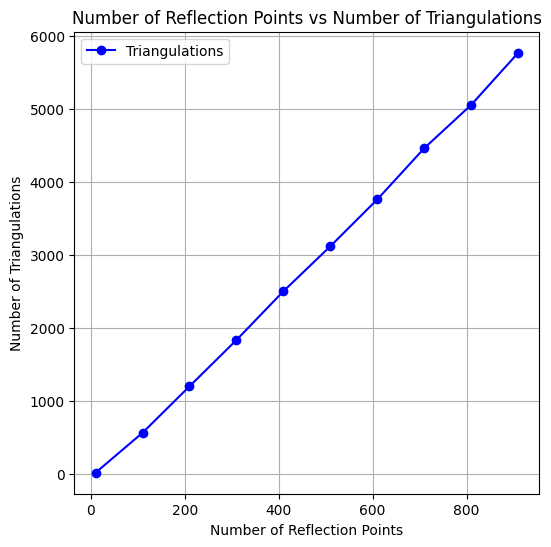

In [ ]:
# Function to generate random 3D points
def generate_points(num_points):
    return np.random.rand(num_points, 3)

# Function to perform Delaunay triangulation and measure time
def compute_triangulation(points):
    start_time = time.time()
    triangulation = Delaunay(points)
    end_time = time.time()
    return len(triangulation.simplices), end_time - start_time

# Reflection points sizes to vary
reflection_sizes = np.arange(10, 1001, 100)

# Lists to store the results
num_points = []
num_triangulations = []
times = []

# Loop over the different sizes of points arrays
for size in reflection_sizes:
    points = generate_points(size)
    num_triangulation, elapsed_time = compute_triangulation(points)
    num_points.append(size)
    num_triangulations.append(num_triangulation)
    times.append(elapsed_time)

# Plot 1: Number of Reflection Points vs Number of Triangulations
plt.figure(figsize=(6, 6))


plt.plot(num_points, num_triangulations, marker='o', color='b', linestyle='-', label="Triangulations")
plt.xlabel("Number of Reflection Points")
plt.ylabel("Number of Triangulations")
plt.title("Number of Reflection Points vs Number of Triangulations")
plt.grid(True)
plt.legend()

# Plot 2: Number of Triangulations vs Time taken to build all triangulations



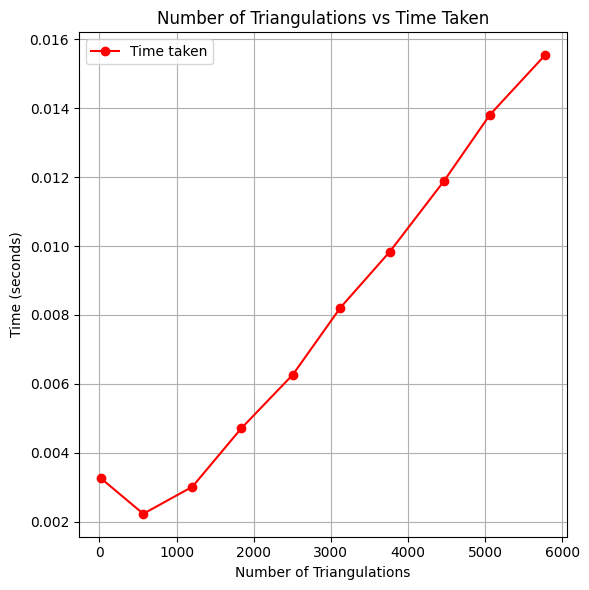

In [ ]:
plt.figure(figsize=(6, 6))
plt.plot(num_triangulations, times, marker='o', color='r', linestyle='-', label="Time taken")
plt.xlabel("Number of Triangulations")
plt.ylabel("Time (seconds)")
plt.title("Number of Triangulations vs Time Taken")
plt.grid(True)
plt.legend()

plt.tight_layout()
plt.show()

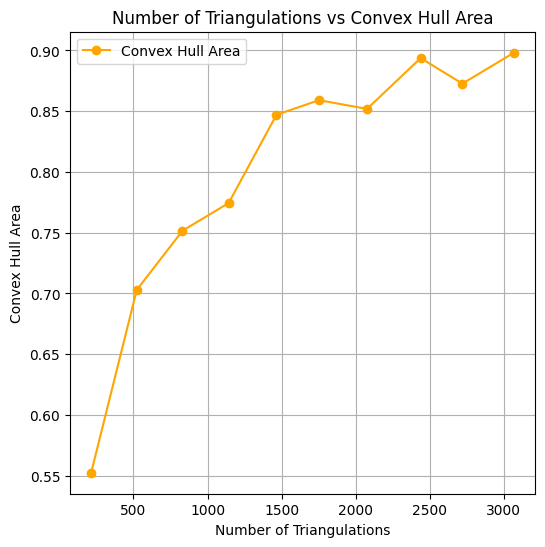

In [ ]:
# Function to generate random 3D points
def generate_points(num_points):
    return np.random.rand(num_points, 3)

# Function to compute Delaunay triangulation and measure time, quality metrics
def compute_triangulation(points):
    start_time = time.time()
    triangulation = Delaunay(points)
    end_time = time.time()

    # Calculate convex hull area
    hull = ConvexHull(points)
    convex_area = hull.volume

    return len(triangulation.simplices), convex_area

# Reflection points sizes to vary
reflection_sizes = np.arange(50, 501, 50)

# Lists to store the results
num_points = []
num_triangulations = []
convex_areas = []

# Loop over the different sizes of points arrays
for size in reflection_sizes:
    points = generate_points(size)
    num_triangulation, convex_area = compute_triangulation(points)
    num_points.append(size)
    num_triangulations.append(num_triangulation)
    convex_areas.append(convex_area)

# Plot: Number of Triangulations vs Convex Hull Area
plt.figure(figsize=(6, 6))
plt.plot(num_triangulations, convex_areas, marker='o', color='orange', linestyle='-', label="Convex Hull Area")
plt.xlabel("Number of Triangulations")
plt.ylabel("Convex Hull Area")
plt.title("Number of Triangulations vs Convex Hull Area")
plt.grid(True)
plt.legend()
plt.show()

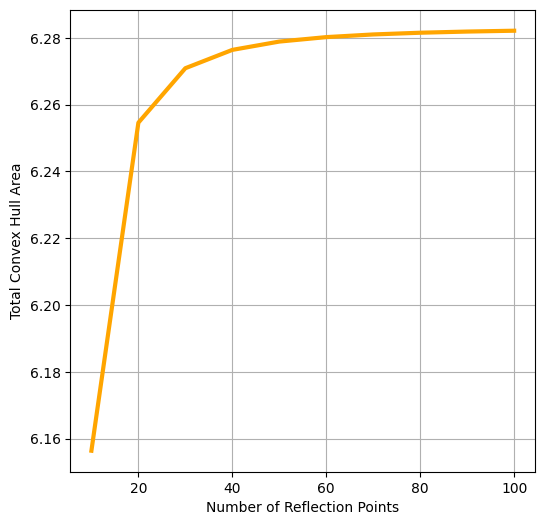

In [ ]:
def calculate_max_convex_hull_area(points):
    try:
        # Compute the convex hull of the points
        hull = ConvexHull(points)
        return hull.area  # Return the area of the convex hull
    except:
        # Return 0 for degenerate cases where no convex hull can be formed
        return 0

def plot_convex_hull_area_vs_reflection_points():
    reflection_sizes = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100]
    convex_areas = []

    for num_points in reflection_sizes:
        # Generate points arranged on a circle to ensure a larger convex hull
        theta = np.linspace(0, 2 * np.pi, num_points)
        points = np.column_stack((np.cos(theta), np.sin(theta)))  # 2D circular arrangement

        area = calculate_max_convex_hull_area(points)  # Calculate convex hull area
        convex_areas.append(area)

    # Plot the results
    plt.figure(figsize=(6, 6))
    plt.plot(reflection_sizes, convex_areas, linewidth=3, color='orange')
    plt.xlabel('Number of Reflection Points')
    plt.ylabel('Total Convex Hull Area')
    plt.grid(True)
    plt.show()

# Call the function to generate the plot
plot_convex_hull_area_vs_reflection_points()
